In [1]:
!git clone https://github.com/Auto-annotation-of-Pathology-Images/AAPI_code

Cloning into 'AAPI_code'...
remote: Enumerating objects: 235, done.
remote: Counting objects: 100% (235/235), done.
remote: Compressing objects: 100% (179/179), done.
remote: Total 1175 (delta 108), reused 163 (delta 54), pack-reused 940
Receiving objects: 100% (1175/1175), 272.62 MiB | 27.17 MiB/s, done.
Resolving deltas: 100% (301/301), done.


You need to restart the runtime after the following 2 ceils

In [1]:
# install dependencies: 
!pip install pyyaml==5.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

1.7.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [2]:
# install detectron2: (Colab has CUDA 10.1 + torch 1.7)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
import torch
assert torch.__version__.startswith("1.7")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
#exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html


In [3]:
from AAPI_code.Collage_generator import collage_generator
from AAPI_code.format_converter import format_converter
from AAPI_code.Collage_generator.utils import *
from PIL import Image
from tqdm.notebook import tqdm
import json

In [4]:
# if you want
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# collage_generator setting

In [ ]:
col_gen = collage_generator(label_list= [], 
                            canvas_size=(3000,3000),
                            example_image = "/content/AAPI_code/data/vignettes/background/11000_16000_0_background.png",
                            gaussian_noise_constant = 5,
                            cluster_size = (2200,2200)
                            )

In [ ]:
col_gen.import_images_from_directory_original_size(root_path="/content/AAPI_code/data/vignettes/train")

image succesfully added to label "artery" with size [255 227]
image succesfully added to label "artery" with size [787 866]
image succesfully added to label "artery" with size [155 548]
image succesfully added to label "artery" with size [343 482]
image succesfully added to label "artery" with size [380 286]
image succesfully added to label "artery" with size [444 489]
image succesfully added to label "artery" with size [2961 1505]
image succesfully added to label "artery" with size [578 827]
image succesfully added to label "artery" with size [795 499]
image succesfully added to label "artery" with size [320 334]
image succesfully added to label "artery" with size [333 223]
image succesfully added to label "artery" with size [637 704]
image succesfully added to label "artery" with size [453 736]
image succesfully added to label "artery" with size [118 130]
image succesfully added to label "artery" with size [274 593]
image succesfully added to label "artery" with size [130 128]
image 

# Generation Example:  
please have format = "COCO"

In [ ]:
collage,mask, color_dict, label_dict = col_gen.generate(item_num= 15,
                                                        ratio_dict={"cluster":0.2, "artery": 0.5, 'arteriole': 0.3},
                                                        background_color = False,
                                                        format = 'COCO'
                                                        )

## Keep the mask as image

It makes further cut possible, once we need to run Detectron2, we parse all the data into the correct format

Original saving:
1. Collage
2. Mask(saved in different color, to distinguish individual instance)
3. Dict(the dict of each individual color to the corresponding class)

In [6]:
fc = format_converter() # all the format utilities is here

In [ ]:
fc.save_coco_raw(collage = collage, 
                 mask = mask, 
                 color_dict = color_dict, 
                 root_path ="output_collage", 
                 name = 'test')

In [ ]:
collage, mask, color_dict = fc.read_coco_raw(root_path = "output", name = 'train')

## If using smaller slide window  
Save the collage, mask into patches, in a rolling window practice

in the saving path, there're:
1. each individual patch with it's mask
2. the copy of color dict

This method can be used on both training and testing

In [ ]:
# this size and offset is using normal human understanding (width, height), not pixel size
# feel free to use np.array([1024,768])
fc.save_sliding_window(collage = collage,
                       mask = mask,
                       color_dict = color_dict,
                       image_name = "image_2",
                       saving_path = "window_slide",
                       window_size = np.array([1024,1024]),
                       offset = np.array([256,256]))

# Parse to COCO
For each time training with Detectron, parse the saved files, it's okay to save multiple {image_name}'s file into one path, parse_detectron can handle that.

for this path, you can create a shortcut of $collage\_detectron$ to your gdrive. 

fc.parse_detectron_ROI is for ROI, it gonna take ~15 min for parsing

In [ ]:
training_set = fc.parse_detectron(path = "/content/drive/MyDrive/collage_detectron/window_slide")
training_set = fc.parse_detectron_ROI(path = "/content/drive/MyDrive/collage_detectron/output")

In [7]:
training_set = fc.parse_detectron_ROI(path = "/content/drive/MyDrive/collage_detectron/output")

# Detectron2

In [8]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

## Detectron use string as the id of dataset，you need：
1. register(str name, func dataset) onto Datacatalog, f need to be a function returning json list
2. get your dataset on MetadataCatalog with the name，set its class，notice that our label is 1-5，you need a background in the front
3. prepare the metadata

In [9]:
DatasetCatalog.register("AAPI_train",lambda p="window_slide": training_set)
MetadataCatalog.get("AAPI_train").set(thing_classes=['background','arteriole', 'artery', 'distal_tubule', 'glomerulus', 'proximal_tubule'])
AAPI_metadata = MetadataCatalog.get("AAPI_train")

## Preview some input

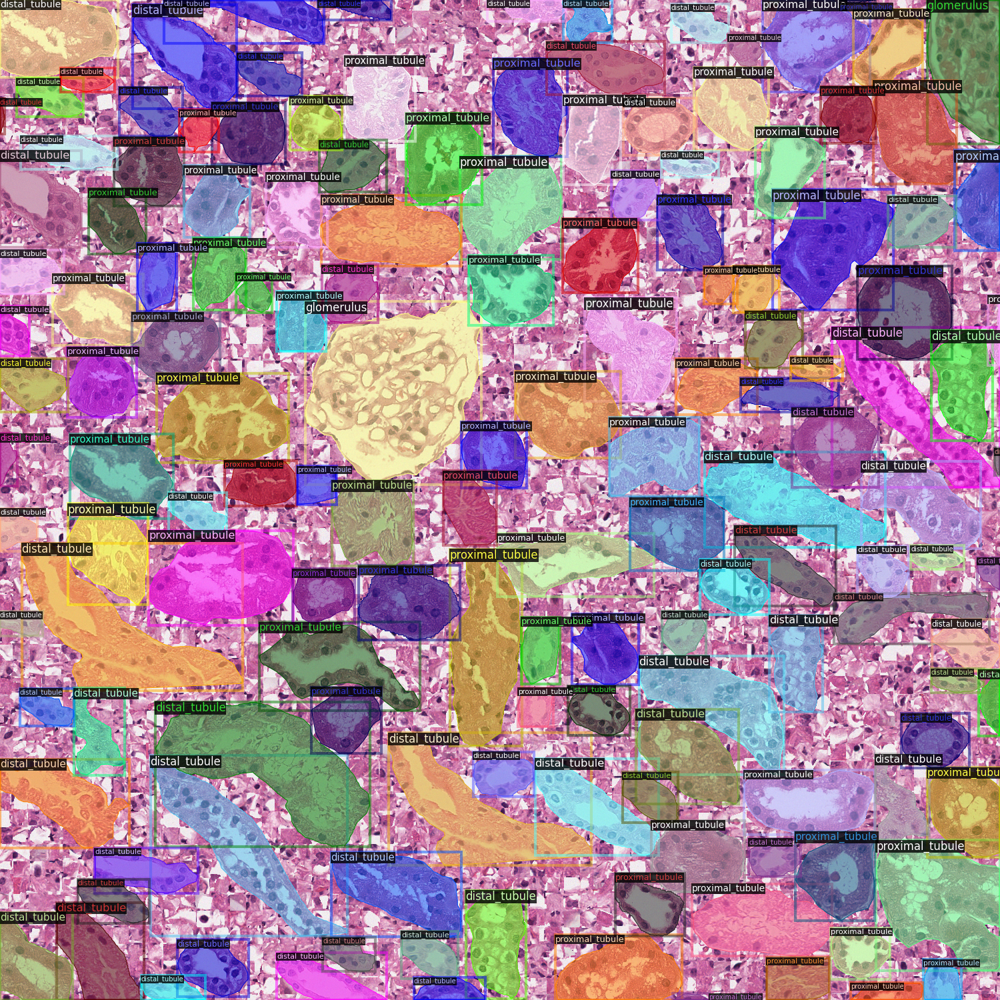

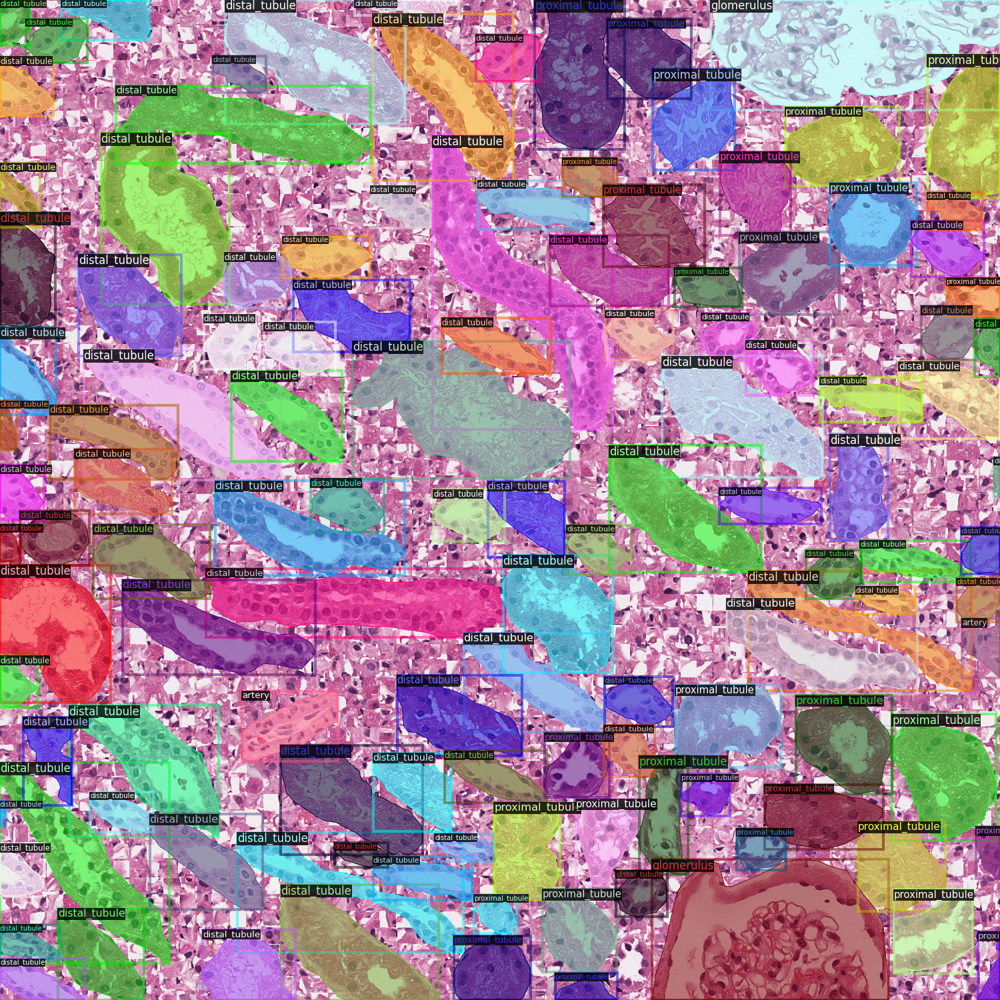

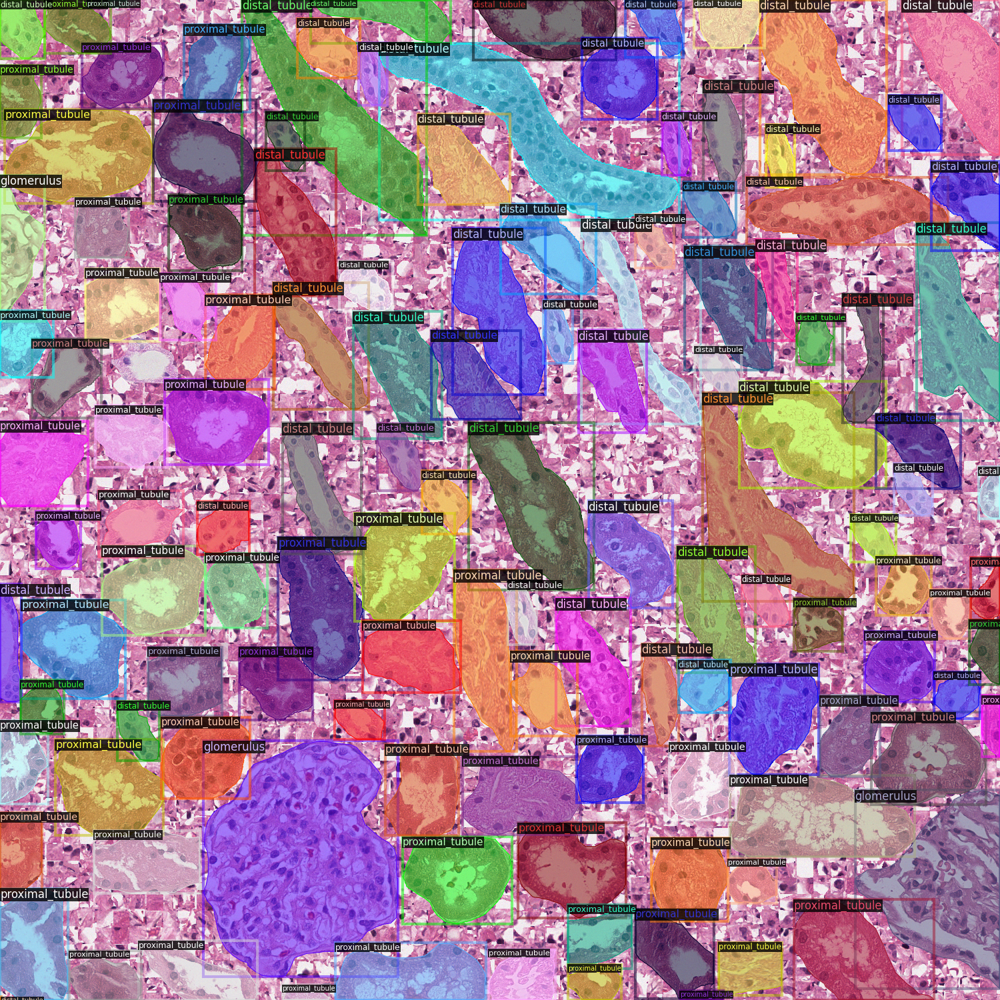

In [11]:
def preview(dataset_dicts, metadata, num = 3):
    for d in random.sample(dataset_dicts, num):
        img = cv2.imread(d["file_name"])
        visualizer = Visualizer(img[:, :, ::-1], metadata=AAPI_metadata, scale=0.5)
        out = visualizer.draw_dataset_dict(d)
        cv2_imshow(out.get_image()[:, :, ::-1])

preview(dataset_dicts = training_set, metadata = AAPI_metadata, num = 3)

## settings and training

In [12]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("AAPI_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 500  
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 32   # Check this, default 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 6  

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[11/24 00:24:59 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:18, 9.77MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (7, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (7,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (24, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (24,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to

[11/24 00:25:21 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:345: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:345: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.6/dist-packages/detectron2/modeling/roi_heads/fast_rcnn.py:217: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/

[11/24 00:25:47 d2.utils.events]:  eta: 0:09:31  iter: 19  total_loss: 8.057  loss_cls: 1.946  loss_box_reg: 0.4699  loss_mask: 0.6915  loss_rpn_cls: 4.437  loss_rpn_loc: 0.4298  time: 1.2443  data_time: 1.1810  lr: 4.9953e-06  max_mem: 2050M
[11/24 00:26:04 d2.utils.events]:  eta: 0:06:26  iter: 39  total_loss: 5.47  loss_cls: 1.786  loss_box_reg: 0.5567  loss_mask: 0.6893  loss_rpn_cls: 1.965  loss_rpn_loc: 0.3648  time: 1.0270  data_time: 0.7107  lr: 9.9902e-06  max_mem: 2050M
[11/24 00:26:20 d2.utils.events]:  eta: 0:06:08  iter: 59  total_loss: 4.002  loss_cls: 1.697  loss_box_reg: 0.6428  loss_mask: 0.6868  loss_rpn_cls: 0.592  loss_rpn_loc: 0.3516  time: 0.9614  data_time: 0.7171  lr: 1.4985e-05  max_mem: 2050M
[11/24 00:26:37 d2.utils.events]:  eta: 0:05:50  iter: 79  total_loss: 3.613  loss_cls: 1.486  loss_box_reg: 0.6198  loss_mask: 0.6824  loss_rpn_cls: 0.4827  loss_rpn_loc: 0.3328  time: 0.9278  data_time: 0.7103  lr: 1.998e-05  max_mem: 2050M
[11/24 00:26:54 d2.utils.even

In [13]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

## Save the model
model is automatically saved at the following path

In [14]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
print(cfg.MODEL.WEIGHTS)

./output/model_final.pth


#Run prediction
## Build a predictor

In [17]:
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.2   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

##If using a test set

In [ ]:
training_set = fc.parse_detectron(path = "whatever path")
training_set = fc.parse_detectron_ROI(path = "whatever path")

DatasetCatalog.register("AAPI_test",lambda p="window_slide_test": test_test)
MetadataCatalog.get("AAPI_test").set(thing_classes=['background','arteriole', 'artery', 'distal_tubule', 'glomerulus', 'proximal_tubule'])
AAPI_metadata = MetadataCatalog.get("AAPI_test")# train and test doesn't matter

## Or, Give your image input here

In [18]:
im = cv2.imread("/content/drive/MyDrive/FFPE PostRep 002/patch/9000_12000_0.png")

## Visualization of the prediction

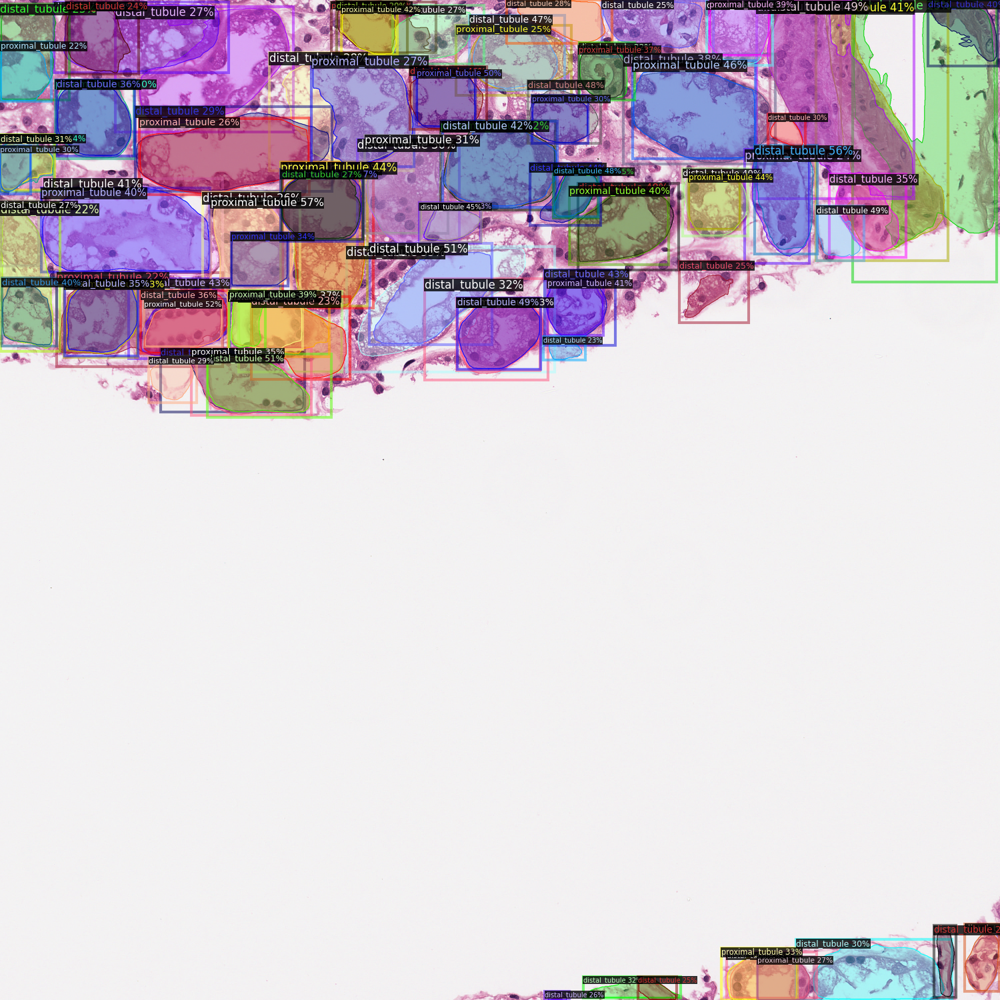

In [20]:
from detectron2.utils.visualizer import ColorMode
outputs = predictor(im) 
v = Visualizer(im[:, :, ::-1],
                metadata=AAPI_metadata, 
                scale=0.5,
                instance_mode=ColorMode.IMAGE_BW)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

Predict on any image

In [21]:
def predict(image):
    """
    image can ba a path or a np.ndarray
    """
    if isinstance(image, str):
        image = cv2.imread(image)
    outputs = predictor(image)
    instances = outputs["instances"]
    return instances
# it need a predictor so I didn't have it inside fc

Everything can be boiled down into:

(3000, 3000)


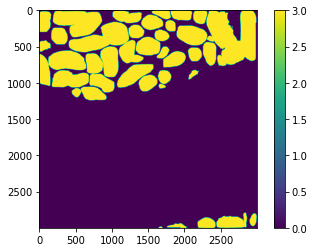

In [22]:
parsed = fc.parse_np_masks(pred_instance = predict(im))# you can have im as a path, it can handle that
print(parsed.shape)
plt.imshow(parsed)
plt.colorbar()